In [1]:
import numpy as np
from numpy.fft import fft, ifft, fftshift, ifftshift, fftfreq
import matplotlib.pyplot as plt
%matplotlib notebook
from scipy.io import wavfile
import IPython.display as ipd
from scipy.ndimage import convolve

In [2]:
rate, gnr_song = wavfile.read("GNR.wav")  # rate in Hz
gnr_song = gnr_song.astype(np.float32)[:, 0]

_, floyd_song = wavfile.read("Floyd.wav")  # rates of the two files are the same
floyd_song = floyd_song.astype(np.float32)[:, 0]

In [3]:
ipd.Audio(gnr_song, rate=rate)

In [4]:
ipd.Audio(floyd_song, rate=rate)

# Question 1
https://en.wikipedia.org/wiki/Overtone: To get rid of overtones filter around 0.

In [5]:
def gabor(song, rate, window_time=0.01, scale=np.inf):
    """
    Otherwise know as the short-time Fourier transform
    
    music: 1D numpy array representing the music
    rate: sampling rate, in samples per second, used to generate this sound
    window_time: time in seconds over which to compute the short-time fourier transform
    scale: standard deviation of the gaussian filter to remove overtones. defaults to infinite (ie. no filtering)
    
    returns: 2D numpy array of the Fourier transform for each window along the song
             axis 0 represent frequencies and axis 1 represent time (window number)
             note: the frequency axis has been fftshifted, so it will be in the original order
    """
    window_width = int(window_time * rate)
    num_windows = len(song) // window_width
    
    if np.isfinite(scale):
        k = fftfreq(window_width)
        kernel = np.exp(-k**2 / (2 * scale**2))
#         print(np.round(kernel, 2))
    
    spectrogram = np.zeros((window_width, num_windows), dtype=np.complex128)
    
    for i in range(num_windows):
        window = song[i * window_width:(i + 1) * window_width]
        fft_window = fft(window)
        if np.isfinite(scale):
            fft_window *= kernel
        spectrogram[:, i] = fft_window
    
    return fftshift(spectrogram, axes=[0])

In [6]:
def freq_to_note(freq):
    """
    Converts a frequency into a note. If the frequency is invalid it returns None
    
    freq: frequency in Hz of the note
    
    returns: str of the form "<octave>:<note>"
    """
    freqs = [65, 69, 73, 78, 82, 87, 92, 98, 104, 110, 117, 123, 131, 139, 147, 156, 165, 175, 185, 196, 208, 220, 233, 247, 262, 277, 294, 311, 330, 349, 370, 392, 415, 440, 466, 494, 523, 554, 587, 622, 659, 698, 740, 784, 831, 880, 932, 988]
    notes = list()
    for i in range(2, 6):
        notes.extend([f"{i}:C", f"{i}:C#", f"{i}:D", f"{i}:D#", f"{i}:E", f"{i}:F", f"{i}:F#", f"{i}:G", f"{i}:G#", f"{i}:A", f"{i}:A#", f"{i}:B"])
    
    if freq < min(freqs) - 5 or freq > max(freqs) + 100:
        return None
    
    idx = np.argmin(abs(freq - freqs))
    return notes[idx]

# GNR guitar

In [181]:
L = 13 / 122
gnr_spectrogram = gabor(gnr_song, rate, window_time=L, scale=0.018)
n = gnr_spectrogram.shape[0]
k_gnr = 1 / L * np.arange(-n // 2, n // 2)  # the smallest magnitude frequency for an L-periodic function should be 1/L

In [182]:
print(gnr_spectrogram.shape)
k_gnr[200:220]

(4699, 128)


array([-20176.92307692, -20167.53846154, -20158.15384615, -20148.76923077,
       -20139.38461538, -20130.        , -20120.61538462, -20111.23076923,
       -20101.84615385, -20092.46153846, -20083.07692308, -20073.69230769,
       -20064.30769231, -20054.92307692, -20045.53846154, -20036.15384615,
       -20026.76923077, -20017.38461538, -20008.        , -19998.61538462])

<IPython.core.display.Javascript object>


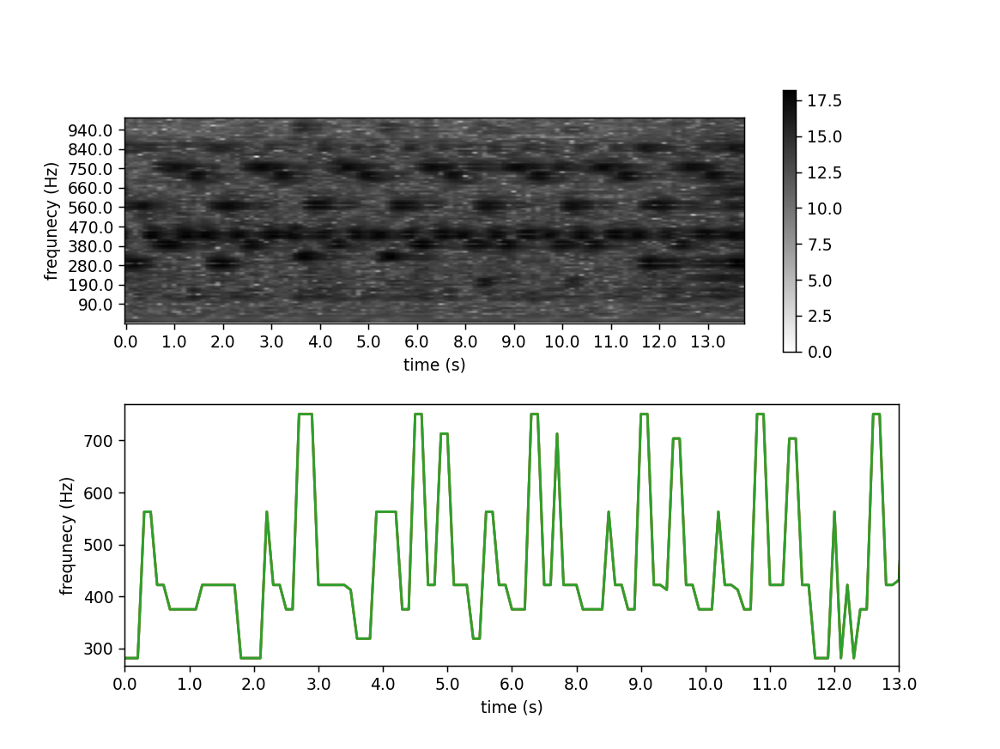

In [213]:
plt.figure()
fl_gnr = abs(gnr_spectrogram[:gnr_spectrogram.shape[0] // 2 + 1]) + abs(gnr_spectrogram[gnr_spectrogram.shape[0] // 2:][::-1])

kernel = np.array([[1, 2, 1],
                   [2, 8, 2],
                   [1, 2, 1]])
conv_gnr = convolve(fl_gnr, kernel, mode="wrap")
kernel = np.array([[-2,-8,-2],
                   [ 2, 8, 2]])
conv_gnr = convolve(conv_gnr, kernel, mode="wrap")

plt.subplot(2,1,1)
plt.imshow(np.log(abs(conv_gnr) + 1), aspect=0.4, cmap="binary")
plt.xlabel("time (s)")
plt.ylabel("frequnecy (Hz)")
plt.xticks(ticks=range(0, fl_gnr.shape[1], 10), labels=np.round(13 / 120 * np.arange(0, fl_gnr.shape[1], 10)))
plt.yticks(ticks=range(fl_gnr.shape[0] - 400, fl_gnr.shape[0], 10), labels=np.round(-k_gnr[range(fl_gnr.shape[0] - 400, fl_gnr.shape[0], 10)], -1))
plt.ylim([fl_gnr.shape[0] - 0, fl_gnr.shape[0] - 500])
plt.colorbar()

<IPython.core.display.Javascript object>


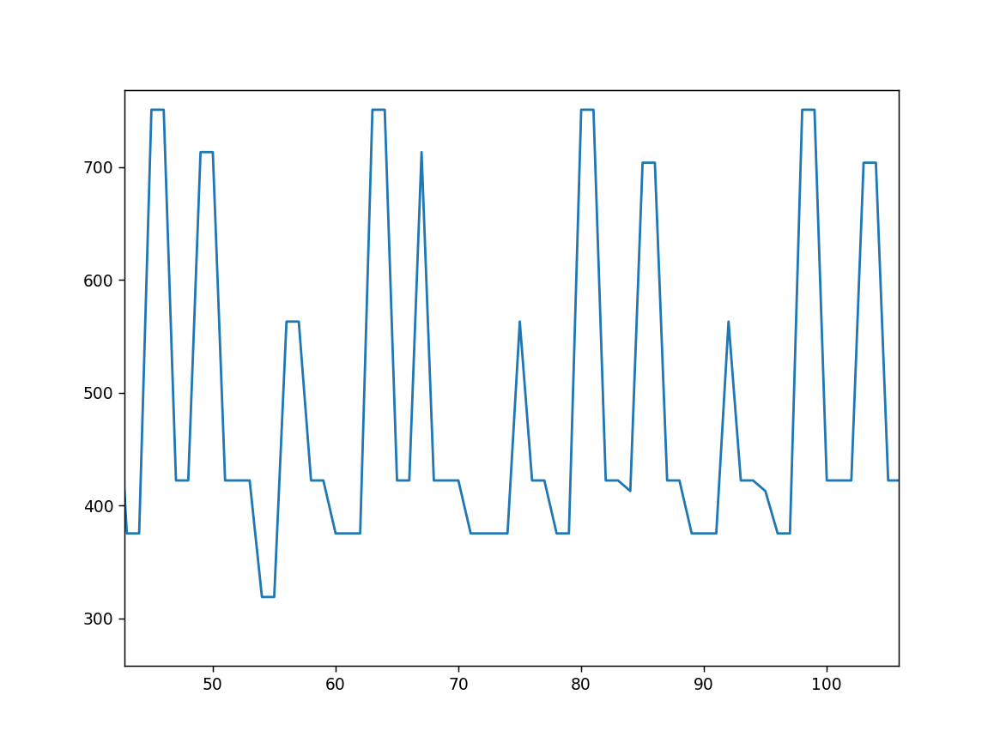

In [201]:
gnr_freqs = -k_gnr[np.argmax(conv_gnr, axis=0)]
# filt_window = np.arange(-10, 11)
# filt = np.exp(-filt_window**2 / 50000)
# cleaned_gnr = abs(gnr_spectrogram[:gnr_spectrogram.shape[0] // 2])
# for t in range(cleaned_gnr.shape[1] - len(filt)):
#     for i in range(cleaned_gnr.shape[0]):
#         cleaned_gnr[i, t:t + len(filt)] = cleaned_gnr[i, t:t + len(filt)] * filt
# gnr_freqs = -k_gnr[np.argmax(cleaned_gnr, axis=0)]

In [216]:
plt.subplot(2,1,2)
# plt.scatter(np.arange(len(gnr_freqs)), gnr_freqs)
plt.plot(gnr_freqs)
plt.xlabel("time (s)")
plt.xticks(ticks=range(0, gnr_freqs.shape[0], 10), labels=np.round(13 / 120 * np.arange(0, gnr_freqs.shape[0], 10)))
plt.ylabel("frequnecy (Hz)")
plt.show()

<ipython-input-216-bf4fc974626a>:1: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(2,1,2)


In [217]:
print(list(freq_to_note(freq) for freq in gnr_freqs[::2]))

['4:C#', '4:C#', '5:C#', '4:G#', '4:F#', '4:F#', '4:G#', '4:G#', '4:G#', '4:C#', '4:C#', '5:C#', '4:G#', '4:F#', '5:F#', '4:G#', '4:G#', '4:G#', '4:D#', '4:D#', '5:C#', '5:C#', '4:F#', '5:F#', '4:G#', '5:F', '4:G#', '4:D#', '5:C#', '4:G#', '4:F#', '4:F#', '5:F#', '4:G#', '4:G#', '4:G#', '4:F#', '4:F#', '4:G#', '4:F#', '5:F#', '4:G#', '4:G#', '5:F', '4:G#', '4:F#', '5:C#', '4:G#', '4:F#', '5:F#', '4:G#', '4:G#', '5:F', '4:G#', '4:C#', '5:C#', '4:G#', '4:F#', '5:F#', '4:G#', '4:A', '4:G#', '4:G#', '4:C#']


# Floyd bass

In [250]:
L = 2
floyd_spectrogram = gabor(floyd_song, rate, window_time=L, scale=0.001)
n = floyd_spectrogram.shape[0]
k_floyd = 1 / L * np.arange(-n // 2, n // 2)  # the smallest magnitude frequency for an L-periodic function should be 1/L

<IPython.core.display.Javascript object>


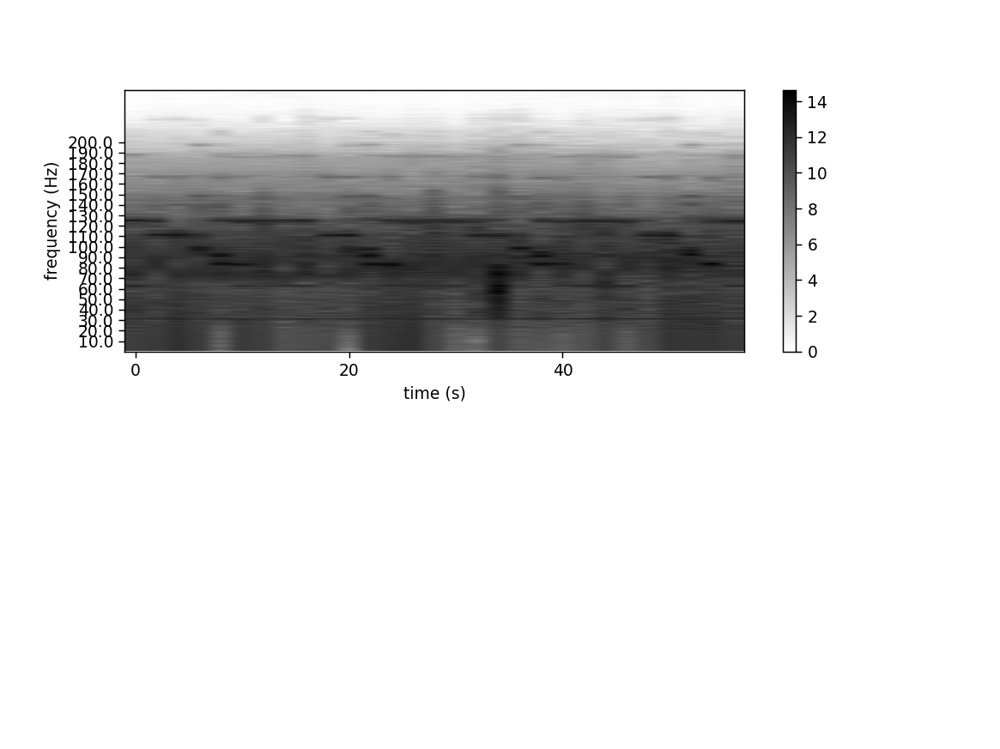

In [251]:
plt.figure()
fl_floyd_spect = abs(floyd_spectrogram[:floyd_spectrogram.shape[0] // 2]) + abs(floyd_spectrogram[floyd_spectrogram.shape[0] // 2:][::-1])
filt_window = np.arange(fl_floyd_spect.shape[0])
cleaned_floyd = fl_floyd_spect

# filt_window = np.arange(-6, 7)
# filt_time = np.exp(-filt_window**2 / 100)
# print(filt_time)
# smoothed_floyd = np.zeros(cleaned_floyd.shape)
# for t in range(cleaned_floyd.shape[1] - len(filt_time)):
#     for i in range(cleaned_floyd.shape[0]):
#         smoothed_floyd[i, t:t + len(filt_time)] = cleaned_floyd[i, t:t + len(filt_time)] * filt_time
kernel = np.array([[-4,-8,-10,-8,-4],
                   [ 4, 8, 10, 8, 4]])
convolved_floyd = convolve(cleaned_floyd, kernel, mode="wrap")

plt.subplot(2,1,1)
plt.imshow(np.log(abs(cleaned_floyd) + 1), aspect="auto", cmap="binary")
plt.xlabel("time (s)")
plt.yticks(ticks=range(cleaned_floyd.shape[0] - 400, cleaned_floyd.shape[0], 20), labels=np.round(-k_floyd[range(cleaned_floyd.shape[0] - 400, cleaned_floyd.shape[0], 20)], -1))
plt.xticks(ticks=range(0, cleaned_floyd.shape[1], 10), labels=np.round(L * np.arange(0, cleaned_floyd.shape[1], 10)))
plt.ylabel("frequency (Hz)")
plt.ylim([cleaned_floyd.shape[0] - 0, cleaned_floyd.shape[0] - 500])
plt.colorbar()

- Figure out a way to have multiple notes extracted at once (how to show on paper?) construct bass manually
- Put figures into paper and write a first draft

<IPython.core.display.Javascript object>


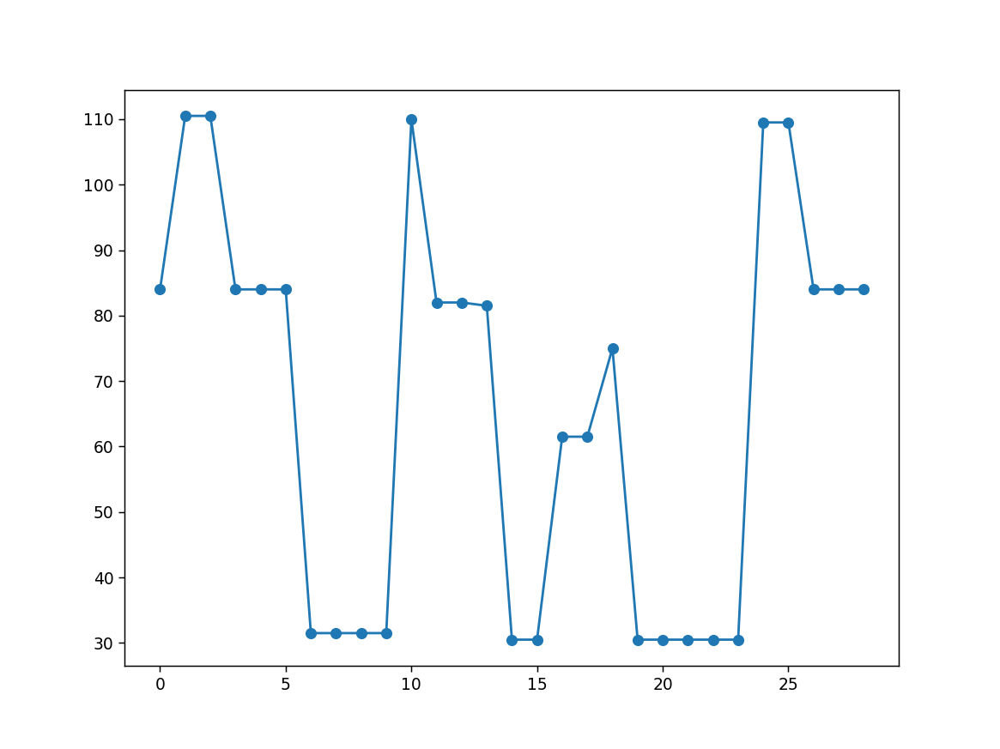

In [236]:
argmax_floyd = np.argmax(abs(convolved_floyd), axis=0)
floyd_freqs = -k_floyd[argmax_floyd]
plt.figure()
plt.scatter(np.arange(len(argmax_floyd)), floyd_freqs)
plt.plot(floyd_freqs)
plt.show()

In [159]:
cleaned_floyd_freqs = list([freq] for freq in floyd_freqs)
print(list((i, cleaned_floyd_freqs[i]) for i in range(110, 121)))

[(110, [87.45762711864407]), (111, [87.45762711864407]), (112, [87.45762711864407]), (113, [87.45762711864407]), (114, [83.38983050847457]), (115, [128.135593220339]), (116, [128.135593220339]), (117, [128.135593220339]), (118, [107.79661016949152]), (119, [107.79661016949152]), (120, [107.79661016949152])]


In [160]:
cleaned_floyd_freqs[5] = cleaned_floyd_freqs[6]
cleaned_floyd_freqs[18].append(cleaned_floyd_freqs[24][0])
cleaned_floyd_freqs[19].append(cleaned_floyd_freqs[24][0])
cleaned_floyd_freqs[20].append(cleaned_floyd_freqs[24][0])
cleaned_floyd_freqs[21].append(cleaned_floyd_freqs[24][0])
cleaned_floyd_freqs[22].append(cleaned_floyd_freqs[24][0])

cleaned_floyd_freqs[50].append(cleaned_floyd_freqs[63][0])
cleaned_floyd_freqs[51].append(cleaned_floyd_freqs[63][0])
cleaned_floyd_freqs[52].append(cleaned_floyd_freqs[63][0])
cleaned_floyd_freqs[53].append(cleaned_floyd_freqs[63][0])
cleaned_floyd_freqs[55] = cleaned_floyd_freqs[63]
cleaned_floyd_freqs[56] = cleaned_floyd_freqs[63]
cleaned_floyd_freqs[57] = cleaned_floyd_freqs[63]
cleaned_floyd_freqs[58] = cleaned_floyd_freqs[63]
cleaned_floyd_freqs[59] = cleaned_floyd_freqs[63]

cleaned_floyd_freqs[79].append(cleaned_floyd_freqs[91][0])
cleaned_floyd_freqs[80].append(cleaned_floyd_freqs[91][0])
cleaned_floyd_freqs[81].append(cleaned_floyd_freqs[91][0])
cleaned_floyd_freqs[82].append(cleaned_floyd_freqs[91][0])
cleaned_floyd_freqs[83].append(cleaned_floyd_freqs[91][0])
cleaned_floyd_freqs[89] = cleaned_floyd_freqs[91]
cleaned_floyd_freqs[90] = cleaned_floyd_freqs[91]

cleaned_floyd_freqs[110].append(cleaned_floyd_freqs[117][0])
cleaned_floyd_freqs[111].append(cleaned_floyd_freqs[117][0])
cleaned_floyd_freqs[112].append(cleaned_floyd_freqs[117][0])
cleaned_floyd_freqs[113].append(cleaned_floyd_freqs[117][0])
cleaned_floyd_freqs[114].append(cleaned_floyd_freqs[117][0])
cleaned_floyd_freqs[118] = cleaned_floyd_freqs[117]
cleaned_floyd_freqs[119] = cleaned_floyd_freqs[117]
cleaned_floyd_freqs[120] = cleaned_floyd_freqs[117]

<IPython.core.display.Javascript object>


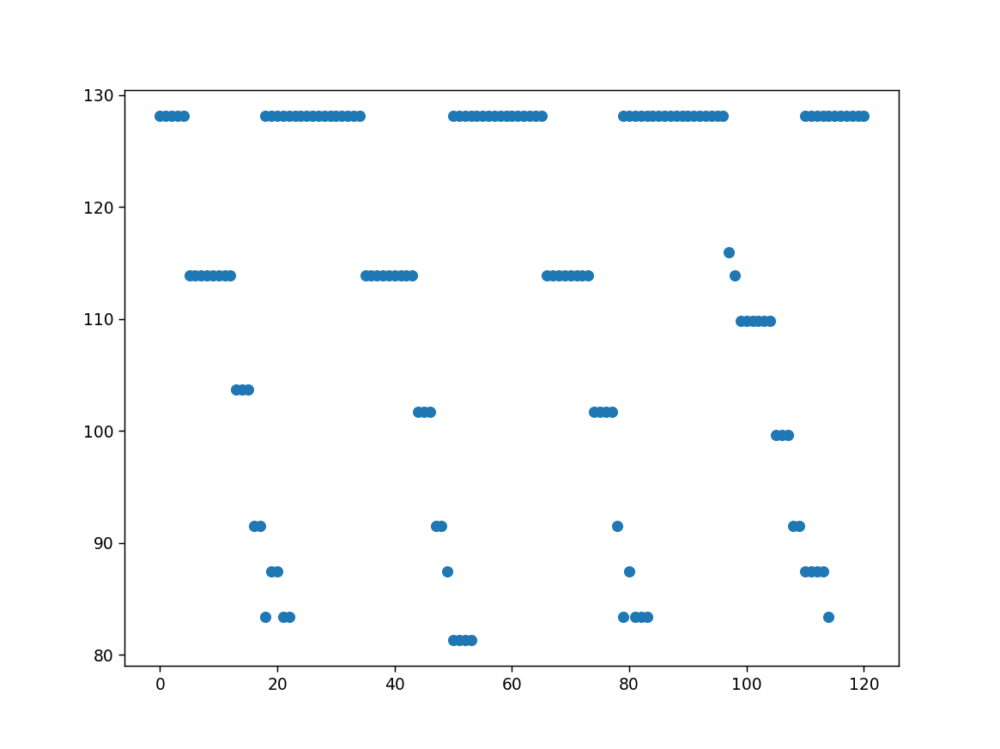

In [161]:
plt.figure()
xl = []
yl = []
for i in range(len(cleaned_floyd_freqs)):
    for j in range(len(cleaned_floyd_freqs[i])):
        xl.append(i)
        yl.append(cleaned_floyd_freqs[i][j])
plt.scatter(xl, yl)
# plt.plot(cleaned_floyd_freqs)
plt.show()

In [225]:
print(list(freq_to_note(freq) for freq in floyd_freqs[::2]))

['3:C', '3:C', '3:C', '2:A#', '2:A#', '2:A#', '2:A#', '2:G#', '2:F#', '2:E', '2:F', '2:E', '3:C', '3:C', '3:C', '3:C', '3:C', '3:C', '2:A#', '2:A#', '2:A#', '2:A#', '2:G#', '2:G#', '2:F#', '2:E', '2:E', '3:C', '2:G', '2:G#', '3:C', '3:C', '3:C', '2:A#', '2:A#', '2:A#', '2:A#', '2:G#', '2:G#', '2:F#', '2:F', '2:E', '3:C', '3:C', '3:C', '2:F#', '3:C', '3:C', '3:C', '2:A#', '2:A', '2:A', '2:A', '2:G', '2:F#', '2:F', '2:F', '2:E', '3:C', '2:A', '2:A']


## Question 2
### Filtering the bass out of Pink Floyd

In [163]:
cleaned_floyd = fl_floyd_spect
floyd_bass = np.zeros(cleaned_floyd.shape)
filt_window = -k_floyd[range(cleaned_floyd.shape[0])]

for t in range(cleaned_floyd.shape[1]):
    for freq in cleaned_floyd_freqs[t]:
        filt = np.exp(-(filt_window - freq)**2 / 20)
#         print(np.round(filt[-100:], 2))
        floyd_bass[:, t] += cleaned_floyd[:, t] * filt

<IPython.core.display.Javascript object>


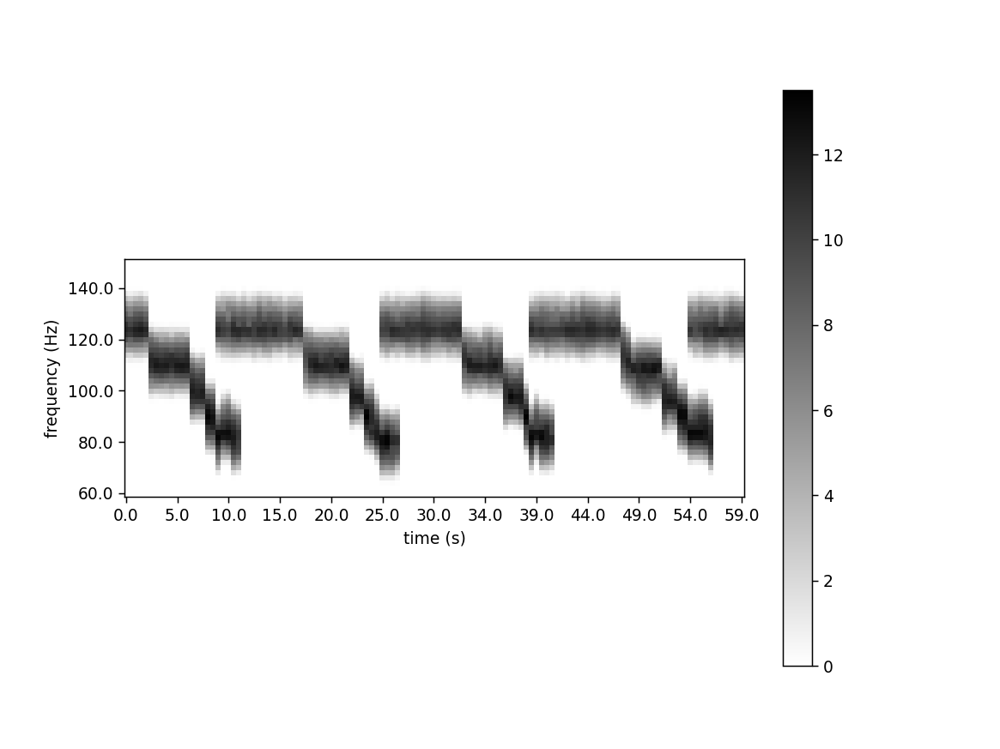

In [218]:
plt.figure()
plt.imshow(np.log(abs(floyd_bass) + 1), aspect=1, cmap="binary")
plt.xlabel("time (s)")
plt.ylabel("frequency (Hz)")
plt.xticks(ticks=range(0, floyd_bass.shape[1], 10), labels=np.round(59 / 120 * np.arange(0, floyd_bass.shape[1], 10)))
plt.yticks(ticks=range(floyd_bass.shape[0] - 400, floyd_bass.shape[0], 10), labels=np.round(-k_floyd[range(floyd_bass.shape[0] - 400, floyd_bass.shape[0], 10)], -1))
plt.ylim([floyd_bass.shape[0] - 20, floyd_bass.shape[0] - 90])
plt.colorbar()

In [143]:
bassline = []
floyd_spect = gabor(floyd_song, rate, window_time=L)
for t in range(floyd_bass.shape[1]):
    section = list(fftshift(ifft(ifftshift(np.concatenate([floyd_bass[:, t], np.flip(floyd_bass[:, t])])))))
#     section = list(fftshift(ifft(ifftshift(floyd_spect[:, t]))))
    bassline.extend(section)


In [144]:
bassline = abs(np.array(bassline)) * np.max(floyd_song) / np.max(bassline)
# bassline = (255 / (np.max(bassline) - np.min(bassline)) * bassline + np.min(bassline))
print(bassline)
print(np.max(floyd_song))

[3.40905162e-14-4.58787999e-30j 4.33231903e-01-5.83040739e-17j
 8.66325889e-01-1.16589587e-16j ... 2.07375725e-01-2.79084932e-17j
 1.38292855e-01-1.86113644e-17j 6.91591405e-02-9.30739314e-18j]
3845.0


In [145]:
ipd.Audio(abs(bassline.astype(np.uint8)), rate=rate)

<ipython-input-145-c9a6a97f0093>:1: ComplexWarning: Casting complex values to real discards the imaginary part
  ipd.Audio(abs(bassline.astype(np.uint8)), rate=rate)


# Floyd Guitar

In [283]:
L = (len(floyd_song) / rate) / (4 * len(cleaned_floyd_freqs))
floyd_spectrogram = gabor(floyd_song, rate, window_time=L, scale=0.01)
n = floyd_spectrogram.shape[0]
k_floyd = 1 / L * np.arange(-n // 2, n // 2)  # the smallest magnitude frequency for an L-periodic function should be 1/L

<IPython.core.display.Javascript object>


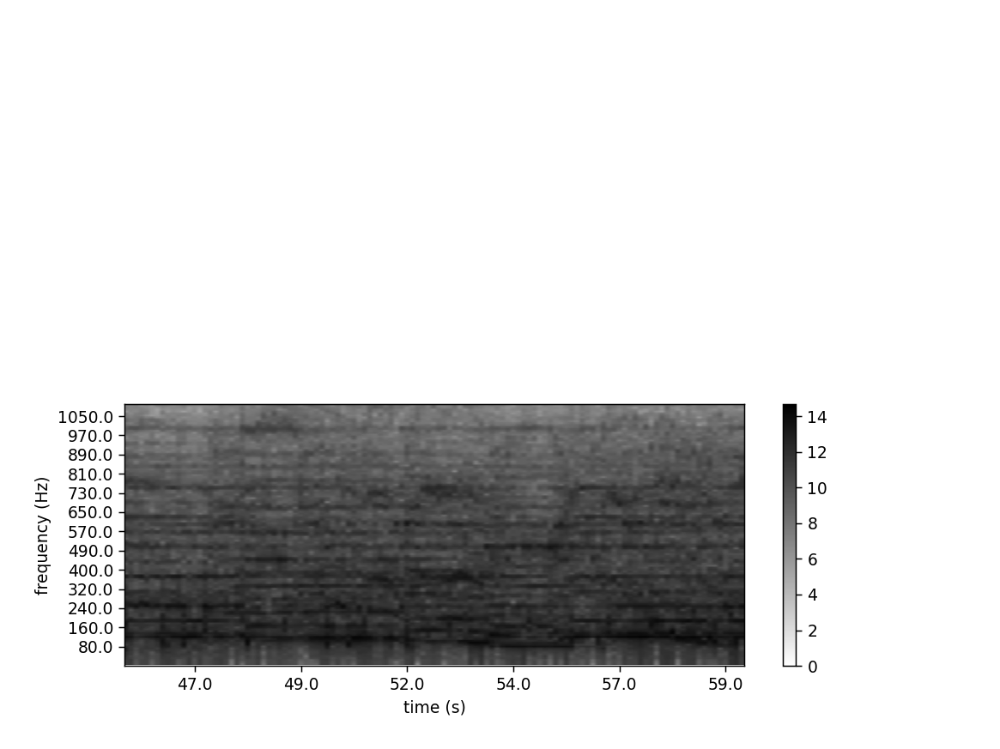

c:\python38\lib\site-packages\numpy\core\_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [311]:
plt.figure()
fl_floyd_spect = abs(floyd_spectrogram[:floyd_spectrogram.shape[0] // 2]) + abs(floyd_spectrogram[floyd_spectrogram.shape[0] // 2:][::-1])
cl_floyd = fl_floyd_spect[:, :]
# kernel = np.array([[1, 2, 1],
#                    [2, 8, 2],
#                    [1, 2, 1]])
# cl_floyd = convolve(cl_floyd, kernel, mode="wrap")
# kernel = np.array([[-2,-8,-2],
#                    [ 2, 8, 2]])
# cl_floyd = convolve(cl_floyd, kernel, mode="wrap")
ups_floyd_freqs = np.repeat(cleaned_floyd_freqs, 4)
floyd_guitar = cl_floyd[:, :]
filt_window = -k_floyd[range(cl_floyd.shape[0])]
for t in range(cl_floyd.shape[1]):
    for base_freq in ups_floyd_freqs[t]:
        for harmonic in range(1, 10):
            freq = base_freq * harmonic
            filt = np.exp(-(filt_window - freq)**2 / 20) * 0.6**harmonic
            # print(np.round(filt[-100:], 2))
            floyd_guitar[:, t] -= cl_floyd[:, t] * filt

plt.subplot(2,1,2)
plt.imshow(np.log(abs(cl_floyd) + 1), aspect="auto", cmap="binary")
plt.xlabel("time (s)")
plt.xticks(ticks=range(0, cl_floyd.shape[1], 20), labels=np.round(L * np.arange(0, cl_floyd.shape[1], 20)))
plt.yticks(ticks=range(cl_floyd.shape[0] - 400, cl_floyd.shape[0], 10), labels=np.round(-k_floyd[range(cl_floyd.shape[0] - 400, cl_floyd.shape[0], 10)], -1))
plt.ylabel("frequency (Hz)")
plt.ylim([cl_floyd.shape[0], cl_floyd.shape[0] - 200])
plt.colorbar()

In [285]:
ipd.Audio(floyd_song, rate=rate)

<IPython.core.display.Javascript object>


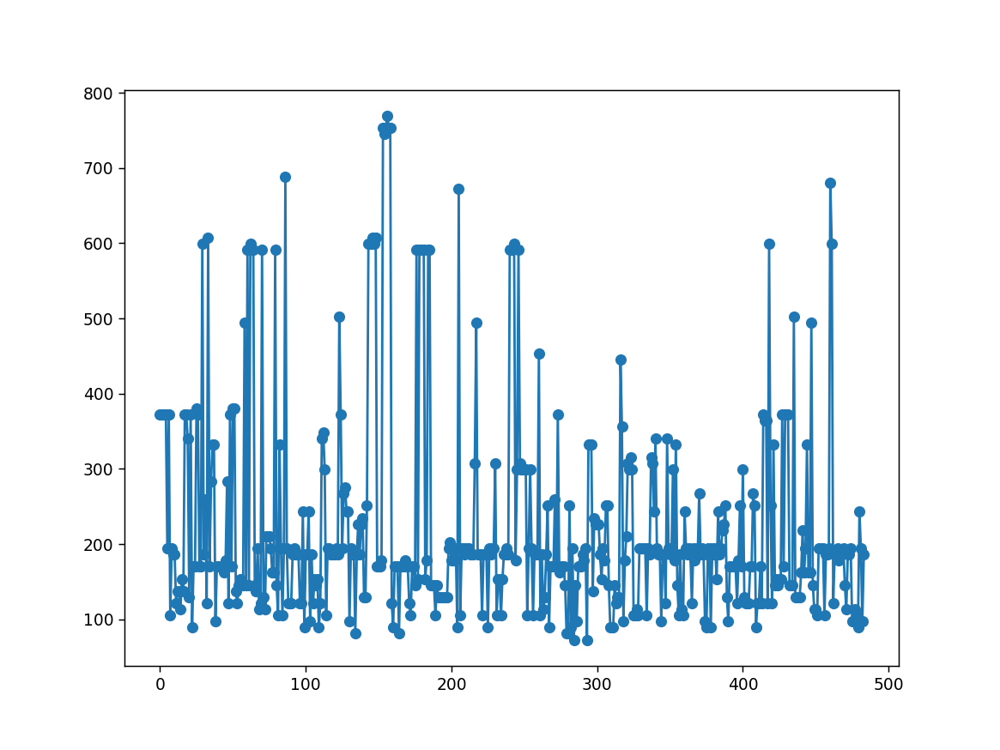

In [303]:
argmax_fguitar = np.argmax(abs(floyd_guitar), axis=0)
guitar_freqs = -k_floyd[argmax_fguitar]
plt.figure()
plt.scatter(np.arange(len(argmax_fguitar)), guitar_freqs)
plt.plot(guitar_freqs)
plt.show()